
---



---
# 〰〰〰〰 Práctica N°2 - "Filtro promedio movil y gaussiano"  〰〰〰〰
---



---



 ---------------------------------------------------- Procesamiento de señales digitales e imagenes  -------------------------------------------------------

      UNIVERSIDAD NACIONAL DE TRUJILLO /  Facultad de Ingeniería / Escuela de Ingeniería Mecatrónica


![https://e.rpp-noticias.io/normal/2015/12/22/285428_50186.jpg](https://vtindustrial.unitru.edu.pe/images/logo.png)

⚙ INTEGRANTES:
*  Asmat Córdova Fernando José
*  Gonzales Leiva Diego André
*  Herrera Hurtado José Ernesto

⚙ DOCENTE:         
*  Ms. Ing. Emerson Maximo Asto Rodriguez

⚙ CICLO:
* VIII





In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


###**2.1. Importación de Librerías y creación de la señal de prueba**

* **Librerias a utilizar:**



In [ ]:
import numpy as np # manejo de arrays
import matplotlib.pyplot as plt # visualizacion de graficos
plt.style.use(['dark_background']) #graficas con fondo oscuro

* **Creacion de una señal con ruido**

In [ ]:
fm = 1000 #frecuencia de muestreo en Hz
t = np.arange(0,3,1/fm) # vector tiempo
n = len(t) #longitud total de la señal
p = 15 #longitud maxima de la señal a generar
amplitud_ruido = 5 #escalamiento del ruido a generar



ampl = np.interp(np.linspace(0,p,n), np.arange(0,p), np.random.rand(p)*30) #señal generada
ruido = amplitud_ruido * np.random.randn(n) #Ruido generado usando una distribucion normal

sen_ruidosa = ampl + ruido #señal ruidosa


* **Mostrando señales generadas:**

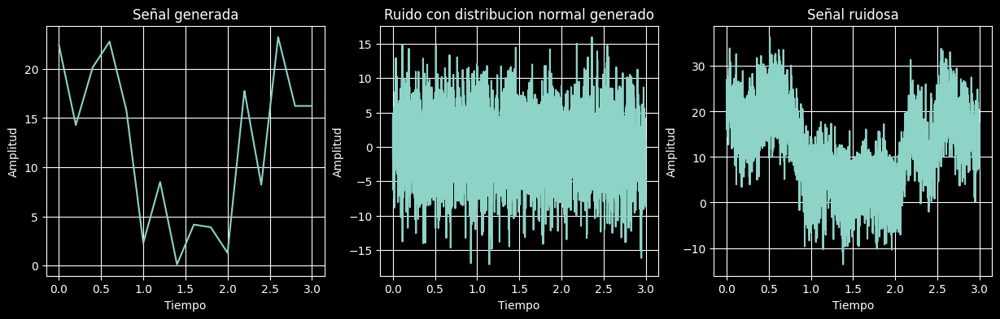

In [ ]:
plt.subplots(1, 3, figsize=(15,4))

plt.subplot(131)
plt.plot(t, ampl)
plt.title("Señal generada")
plt.xlabel("Tiempo")
plt.ylabel("Amplitud")
plt.grid()

plt.subplot(132)
plt.plot(t, ruido)
plt.title("Ruido con distribucion normal generado")
plt.xlabel("Tiempo")
plt.ylabel("Amplitud")
plt.grid()

plt.subplot(133)
plt.plot(t, sen_ruidosa)
plt.title("Señal ruidosa")
plt.xlabel("Tiempo")
plt.ylabel("Amplitud")
plt.grid()

plt.show()

### **2.2. Filtro media movil**

* **Estructura del filtro:**

![promedio movil.png](https://i.ibb.co/qgv7gP5/promedio-movil.png=100x20)

* **Mas referencias teóricas: **
1. [Media Movil](https://es.wikipedia.org/wiki/Media_m%C3%B3vil)
2. Consultar el libro [2] de la bibliografia del curso en la pagina 38.



* **Aplicación del filtro media movil:**

In [ ]:
sen_filtrada = np.zeros(n) #Inicializamos el vector de salida, con el mismo tamaño que la señal creada.

k = 20 #La ventgna u orden del filtro es 2*K+1 = 41.
for i in range(k,n-k-1): #Los indices no tienen que salir del rango de la señal.
  sen_filtrada[i] = np.mean(sen_ruidosa[i-k:i+k]) #Cada salida del filtro es el promedio de la ventana.

tam_ventana = 1000*(k*2+1) / fm # Se calcula el tamaño de la ventana en milisegundos.

* **Gráficas de los resutados:**

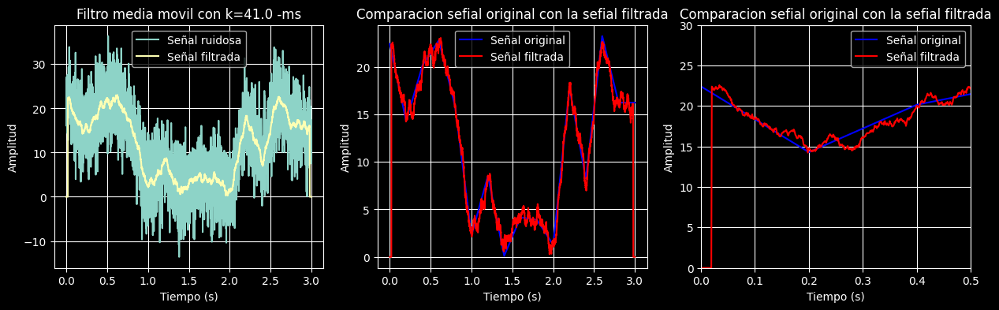

In [ ]:
plt.subplots(1,3, figsize=(15, 4))

plt.subplot(131)
plt.plot(t, sen_ruidosa, label="Señal ruidosa")
plt.plot(t, sen_filtrada, label="Señal filtrada")
plt.title(f"Filtro media movil con k={tam_ventana} -ms")
plt.xlabel("Tiempo (s)")
plt.ylabel("Amplitud")
plt.grid()
plt.legend()

plt.subplot(132)
plt.plot(t, ampl, "b", label="Señal original")
plt.plot(t, sen_filtrada, "r" ,label="Señal filtrada")
plt.title((f"Comparacion sefial original con la sefial filtrada"))
plt.xlabel("Tiempo (s)")
plt.ylabel("Amplitud")
plt.grid()
plt.legend()


plt.subplot(133)
plt.plot(t, ampl, "b", label="Señal original")
plt.plot(t, sen_filtrada, "r" ,label="Señal filtrada")
plt.title((f"Comparacion sefial original con la sefial filtrada"))
plt.xlabel("Tiempo (s)")
plt.ylabel("Amplitud")
plt.axis([0, 0.5, 0, 30])
plt.grid()
plt.legend()

plt.show()


### **2.3. Filtro Gaussiano**

* **Ecuacion para creacion del filtro:**

![Ecuacion Gaussiana](https://i.ibb.co/QCJZ27n/gauss-filter.png)


* **Referencias teoricas:**
1. [Filtro Gaussiano](https://en.wikipedia.org/wiki/Gaussian_filter)

2. [FWHM](https://https://en.wikipedia.org/wiki/Full_width_at_half_maximum#:~:text=In%20a%20distribution%2C%20full%20width,half%20of%20its%20maximum%20value.&text=If%20the%20FWHM%20of%20a,be%20integrated%20by%20simple%20multiplication.)

* **Creación del filtro gaussiano:**

In [ ]:
FWHM = 25 # Establecemos un FWHM teorico de 25 ms.

k = 100 #Valor para establecer el tamafio de la ventana gaussiana 2*k = 200.
gt = 1000*np.arange(-k,k)/fm # tiempo normalizado de la funcidén gaussiana en ms.

filtro_gaussiano = np.exp( -(4*np.log(2)*gt**2) / FWHM**2 ) #Creacion del filtro gaussiano.
filtro_gaussiano_normalizado = filtro_gaussiano / np.sum(filtro_gaussiano) #Normalizado de la ganancia a 1

# Calculo empirico del tamafio de FWHM en ms
ind_flanco_bajada = k + np.argmin( (filtro_gaussiano[k:]-.5)**2 ) #Indice de la mitad del flanco de subida.
ind_flanco_subida = np.argmin( (filtro_gaussiano-.5)**2 )  #Indice de la mitad del flanco de subida.

FWHM_calculado = gt[ind_flanco_subida] - gt[ind_flanco_bajada] #Duracion del FWHM en ms

* **Mostrando el filtro gaussiano construido:**

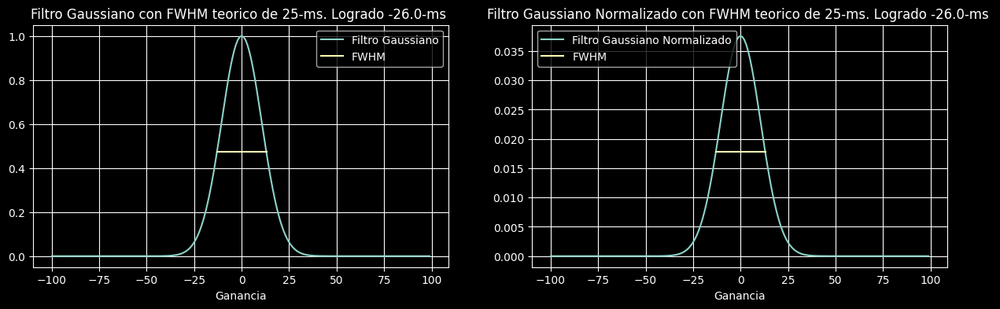

In [ ]:
plt.subplots(1,2, figsize=(15,4))

plt.subplot (121)
plt.plot(gt,filtro_gaussiano, label="Filtro Gaussiano") #Grafica de la funcion gaussiana construida
plt.plot([gt[ind_flanco_subida], gt[ind_flanco_bajada]],
         [filtro_gaussiano[ind_flanco_subida], filtro_gaussiano[ind_flanco_bajada]],
         label = "FWHM") #Grafica de la linea FWHM

plt.title(f"Filtro Gaussiano con FWHM teorico de {FWHM}-ms. Logrado {FWHM_calculado}-ms ")
plt.xlabel('Tiempo (ms)')
plt.xlabel('Ganancia')
plt.grid()
plt.legend()

plt.subplot (122)
plt.plot(gt,filtro_gaussiano_normalizado, label="Filtro Gaussiano Normalizado") #Grafica de la funcion gaussian
plt.plot([gt[ind_flanco_subida], gt[ind_flanco_bajada]],
         [filtro_gaussiano_normalizado[ind_flanco_subida],filtro_gaussiano_normalizado[ind_flanco_bajada]],
         label = "FWHM")  #Grafica de la linea FWHM

plt.title(f"Filtro Gaussiano Normalizado con FWHM teorico de {FWHM}-ms. Logrado {FWHM_calculado}-ms ")
plt.xlabel('Tiempo (ms)')
plt.xlabel('Ganancia')
plt.grid()
plt.legend()

plt.show()

* **Aplicación del filtro Gaussiano:**

In [ ]:
sen_filtrada_gauss = np.zeros_like(sen_ruidosa)

#E1 orden del filtro es 2*K = 200
for i in range(k+1,n-k-1): #Los indices no tienen que salir del rango de la sefial.
  sen_filtrada_gauss[i] = np.sum(sen_ruidosa[i-k:i+k]*filtro_gaussiano_normalizado) #Cada salida es ponderado

* **Mostrando los resultados:**

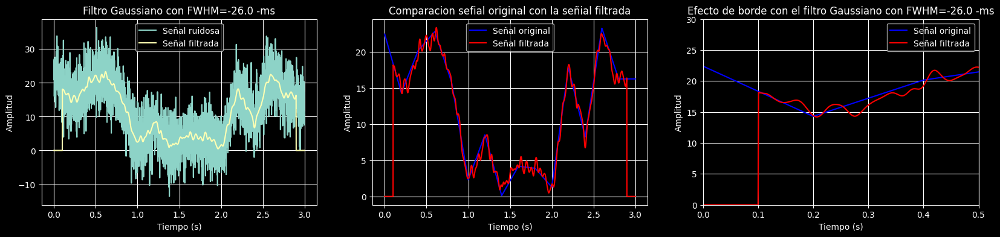

In [ ]:
plt.subplots(1,3, figsize=(20, 4))

plt.subplot(131)
plt.plot(t, sen_ruidosa, label="Señal ruidosa")
plt.plot(t, sen_filtrada_gauss, label="Señal filtrada")
plt.title(f"Filtro Gaussiano con FWHM={FWHM_calculado} -ms")
plt.xlabel("Tiempo (s)")
plt.ylabel("Amplitud")
plt.grid()
plt.legend()

plt.subplot(132)
plt.plot(t, ampl, "b", label="Señal original")
plt.plot(t, sen_filtrada_gauss, "r" ,label="Señal filtrada")
plt.title((f"Comparacion sefial original con la señial filtrada"))
plt.xlabel("Tiempo (s)")
plt.ylabel("Amplitud")
plt.grid()
plt.legend()


plt.subplot(133)
plt.plot(t, ampl, "b", label="Señal original")
plt.plot(t, sen_filtrada_gauss, "r" ,label="Señal filtrada")
plt.title((f"Efecto de borde con el filtro Gaussiano con FWHM={FWHM_calculado} -ms"))
plt.xlabel("Tiempo (s)")
plt.ylabel("Amplitud")
plt.axis([0, 0.5, 0, 30])
plt.grid()
plt.legend()

plt.show()


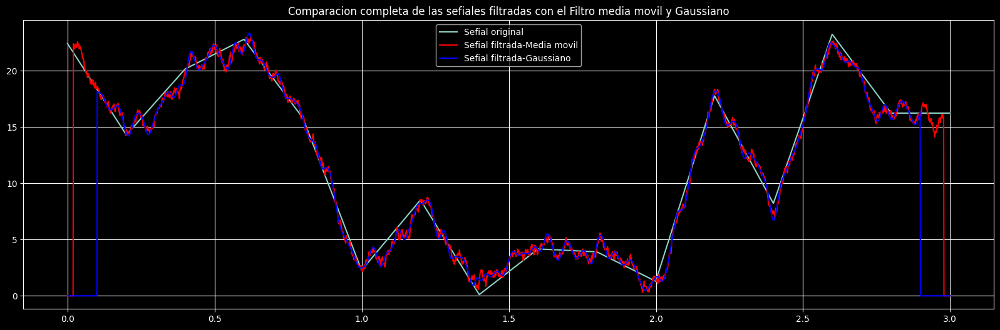

In [ ]:
plt.subplots(figsize=(20, 6))

plt.plot(t, ampl,label="Sefial original")
plt.plot(t, sen_filtrada, "r", label="Sefial filtrada-Media movil")
plt.plot(t, sen_filtrada_gauss, "b", label="Sefial filtrada-Gaussiano")
plt.title(f"Comparacion completa de las sefiales filtradas con el Filtro media movil y Gaussiano")
plt.grid()
plt.legend()

plt.show()

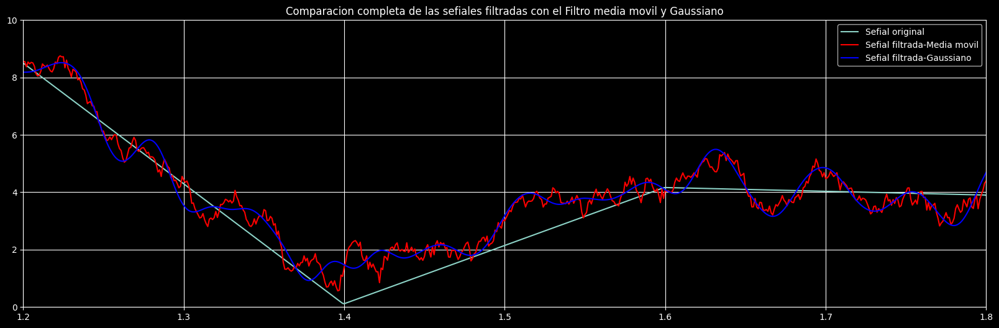

In [ ]:
plt.subplots(figsize=(20, 6))

plt.plot(t, ampl,label="Sefial original")
plt.plot(t, sen_filtrada, "r", label="Sefial filtrada-Media movil")
plt.plot(t, sen_filtrada_gauss, "b", label="Sefial filtrada-Gaussiano")
plt.title(f"Comparacion completa de las sefiales filtradas con el Filtro media movil y Gaussiano")
plt.grid()
plt.axis([1.2, 1.8, 0, 10])
plt.legend()

plt.show()

---



---
# 〰〰〰〰〰〰〰〰〰〰〰〰 **Laboratorio N°1** 〰〰〰〰〰〰〰〰〰〰〰〰
---



---


###**1. Resultados**













**a. Utilizar la librería pysoundfile para leer cualquier audio wav, luego aplique un filtro media móvil de orden 101. Finalmente muestre una comparación entre la gráfica del audio original y la gráfica del audio filtrado:**

In [1]:
!pip install pysoundfile
!pip install bitstring
import IPython
import soundfile
import matplotlib.pyplot as plt
import numpy as np # manejo de arrays
import matplotlib.pyplot as plt # visualizacion de graficos
plt.style.use(['dark_background']) #graficas con fondo oscuro

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.0/60.0 kB 477.2 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 286.2/286.2 kB 4.1 MB/s eta 0:00:00


* **Audio Original**

In [2]:
!gdown --id 1tejaAMUkyhjJS_EERkN_2zlJ41EGkrvA

IPython.display.Audio('elissir.wav')

/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1tejaAMUkyhjJS_EERkN_2zlJ41EGkrvA
To: /content/elissir.wav
100% 5.80M/5.80M [00:00<00:00, 25.6MB/s]


* **Audio Stereo a Mono**

In [3]:
audio_stereo, fm = soundfile.read('elissir.wav')
type(audio_stereo) #Tiene una segunda dimension
print(audio_stereo)

audio_signal = np.mean(audio_stereo, axis=1)

type(audio_signal) #una sola dimension
print(audio_signal)

[[ 0.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00]
 ...
 [-3.05175781e-05 -3.05175781e-05]
 [-3.05175781e-05 -3.05175781e-05]
 [-3.05175781e-05 -3.05175781e-05]]
[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -3.05175781e-05
 -3.05175781e-05 -3.05175781e-05]


* **Mostrando Señal del Audio**

Tasa de muestreo: 48000 muestras/segundo
Tamaño de la señal: 1451155 muestras
Duracion: 30.232 segundos


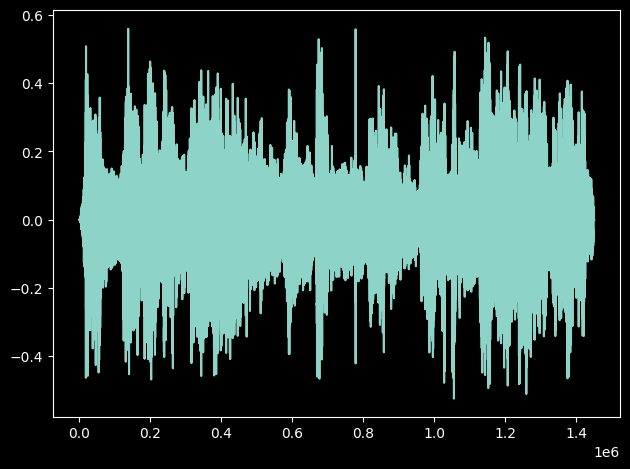

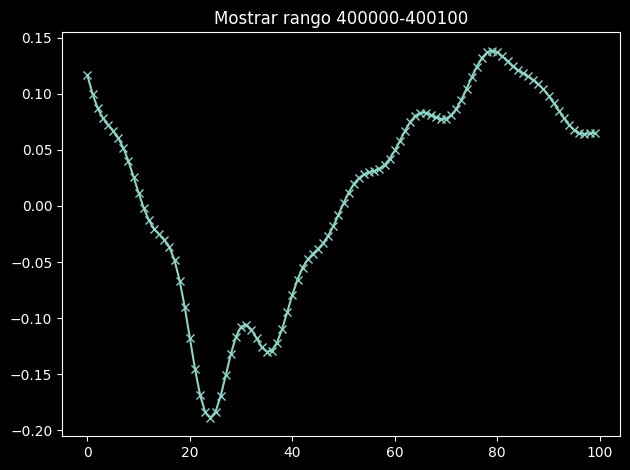

In [4]:
print('Tasa de muestreo: {} muestras/segundo'.format(fm))
print('Tamaño de la señal: {} muestras'.format(audio_signal.shape[0]))
print('Duracion: {:.3f} segundos'.format(audio_signal.shape[0] / fm))
plt.plot(audio_signal)
plt.tight_layout()
plt.figure()
plt.plot(audio_signal[400000:400100], marker='x')
plt.title('Mostrar rango 400000-400100')
plt.tight_layout()

* **Añadiendo más ruido a la señal original**

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


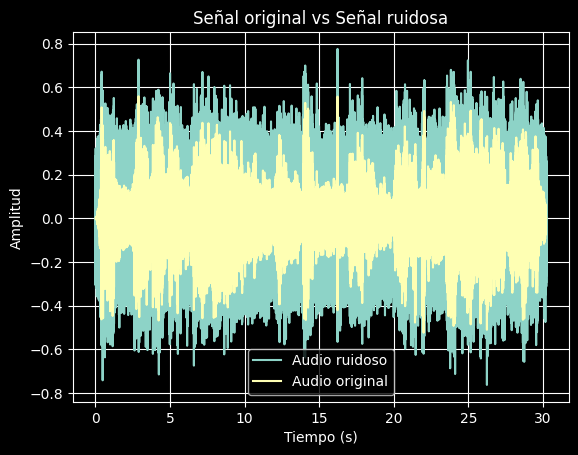

In [5]:
t = np.linspace(0,30.232,audio_signal.shape[0]) # vector tiempo
l = len(audio_signal)

amplitud_ruido = 0.1
ruido = amplitud_ruido * np.random.randn(l)
audio_ruidoso = audio_signal + ruido

plt.plot(t, audio_ruidoso, label="Audio ruidoso")
plt.plot(t, audio_signal, label="Audio original")
plt.title("Señal original vs Señal ruidosa")
plt.xlabel("Tiempo (s)")
plt.ylabel("Amplitud")
plt.grid()
plt.legend()
plt.show()

In [6]:
soundfile.write('elissir_ruidoso.wav', audio_ruidoso, fm)
IPython.display.Audio('elissir_ruidoso.wav')



* **Aplicando Filtro media movil a la señal ruidosa**

In [7]:
audio_filtrado = np.zeros(l) #Inicializamos el vector de salida, con el mismo tamafio que la sefial creada.
k = 50 #La ventgna u orden del filtro es 2*K+1 = 101.
for i in range(k,l-k-1): #Los indices no tienen que salir del rango de la señal.
  audio_filtrado[i] = np.mean(audio_ruidoso[i-k:i+k]) #Cada salida del filtro es el promedio de la ventana.

tam_ventana = 1000*(k*2+1) / fm # Se calcula el tamafio de la ventana en milisegundos.

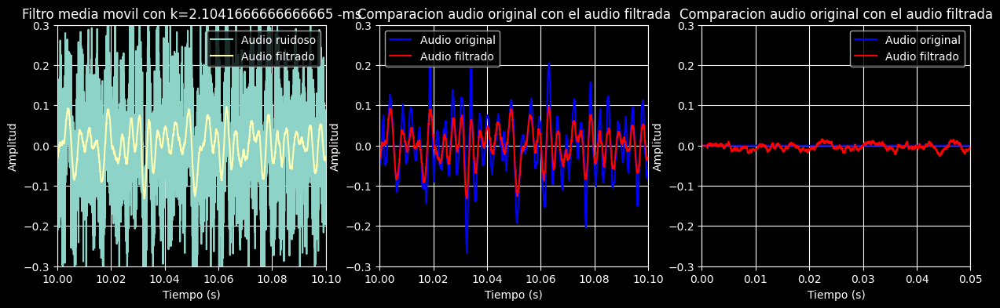

In [8]:
plt.subplots(1,3, figsize=(15, 4))

plt.subplot(131)
plt.plot(t, audio_ruidoso, label="Audio ruidoso")
plt.plot(t, audio_filtrado, label="Audio filtrado")
plt.title(f"Filtro media movil con k={tam_ventana} -ms")
plt.xlabel("Tiempo (s)")
plt.ylabel("Amplitud")
plt.axis([10,10.1, -0.3, 0.3])
plt.grid()
plt.legend()

plt.subplot(132)
plt.plot(t, audio_signal, "b", label="Audio original")
plt.plot(t, audio_filtrado, "r" ,label="Audio filtrado")
plt.title((f"Comparacion audio original con el audio filtrada"))
plt.xlabel("Tiempo (s)")
plt.ylabel("Amplitud")
plt.axis([10,10.1, -0.3, 0.3])
plt.grid()
plt.legend()


plt.subplot(133)
plt.plot(t, audio_signal, "b", label="Audio original")
plt.plot(t, audio_filtrado, "r" ,label="Audio filtrado")
plt.title((f"Comparacion audio original con el audio filtrada"))
plt.xlabel("Tiempo (s)")
plt.ylabel("Amplitud")
plt.axis([0, 0.05, -0.3, 0.3])
plt.grid()
plt.legend()

plt.show()

In [9]:
soundfile.write('elissir_filtrado.wav', audio_filtrado, fm)

IPython.display.Audio('elissir_filtrado.wav')


**Responda:**

**¿Que efecto sonoro identifica entre el audio original y el modificado?** (Media movil)

> Se puede apreciar que al aplicar el filtro de media movil, las fluctuaciones rápidas en la amplitud de la señal se suavizan y se hacen menos "ruidosas" en comparación a la señal original. Esto significa que los detalles de alta frecuencia, como los transitorios o picos rápidos de sonido, se atenuarán en el audio filtrado, lo que puede dar como resultado una percepción de suavidad o atenuación en el sonido en comparación con el audio original.



**b. Utilizar la librería pysoundfile para leer cualquier audio wav, luego aplique un filtro media móvil de orden 101. Finalmente muestre una comparación entre la gráfica del audio original y la gráfica del audio filtrado:**

* **Creando Filtro Gaussiano**

In [10]:
FWHM = 2 # Establecemos un FWHM teorico de 25 ms.

k = 50 #Valor para establecer el tamafio de la ventana gaussiana 2*k = 100.
gt = 1000*np.arange(-k,k)/fm # tiempo normalizado de la funcidén gaussiana en ms.

filtro_gaussiano = np.exp( -(4*np.log(2)*gt**2) / FWHM**2 ) #Creacion del filtro gaussiano.
filtro_gaussiano_normalizado = filtro_gaussiano / np.sum(filtro_gaussiano) #Normalizado de la ganancia a 1

# Calculo empirico del tamafio de FWHM en ms
ind_flanco_bajada = k + np.argmin( (filtro_gaussiano[k:]-.5)**2 ) #Indice de la mitad del flanco de subida.
ind_flanco_subida = np.argmin( (filtro_gaussiano-.5)**2 )  #Indice de la mitad del flanco de subida.

FWHM_calculado = gt[ind_flanco_subida] - gt[ind_flanco_bajada] #Duracion del FWHM en ms

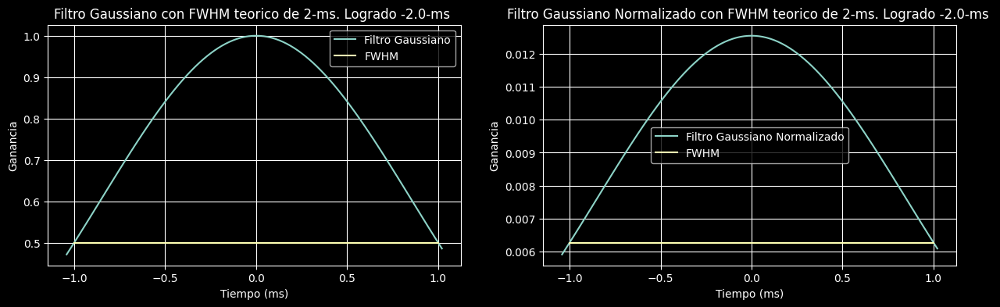

In [11]:
plt.subplots(1,2, figsize=(15,4))

plt.subplot (121)
plt.plot(gt,filtro_gaussiano, label="Filtro Gaussiano") #Grafica de la funcion gaussiana construida
plt.plot([gt[ind_flanco_subida], gt[ind_flanco_bajada]],
         [filtro_gaussiano[ind_flanco_subida], filtro_gaussiano[ind_flanco_bajada]],
         label = "FWHM") #Grafica de la linea FWHM

plt.title(f"Filtro Gaussiano con FWHM teorico de {FWHM}-ms. Logrado {FWHM_calculado}-ms ")
plt.xlabel('Tiempo (ms)')
plt.ylabel('Ganancia')
plt.grid()
plt.legend()

plt.subplot (122)
plt.plot(gt,filtro_gaussiano_normalizado, label="Filtro Gaussiano Normalizado") #Grafica de la funcion gaussian
plt.plot([gt[ind_flanco_subida], gt[ind_flanco_bajada]],
         [filtro_gaussiano_normalizado[ind_flanco_subida],filtro_gaussiano_normalizado[ind_flanco_bajada]],
         label = "FWHM")  #Grafica de la linea FWHM

plt.title(f"Filtro Gaussiano Normalizado con FWHM teorico de {FWHM}-ms. Logrado {FWHM_calculado}-ms ")
plt.xlabel('Tiempo (ms)')
plt.ylabel('Ganancia')
plt.grid()
plt.legend()

plt.show()

* **Aplicando Filtro Gaussiano a la señal ruidosa**

In [12]:
audio_filtrado_gauss = np.zeros_like(audio_ruidoso)

#E1 orden del filtro es 2*K = 200
for i in range(k+1,l-k-1): #Los indices no tienen que salir del rango de la sefial.
  audio_filtrado_gauss[i] = np.sum(audio_ruidoso[i-k:i+k]*filtro_gaussiano_normalizado) #Cada salida es ponderado



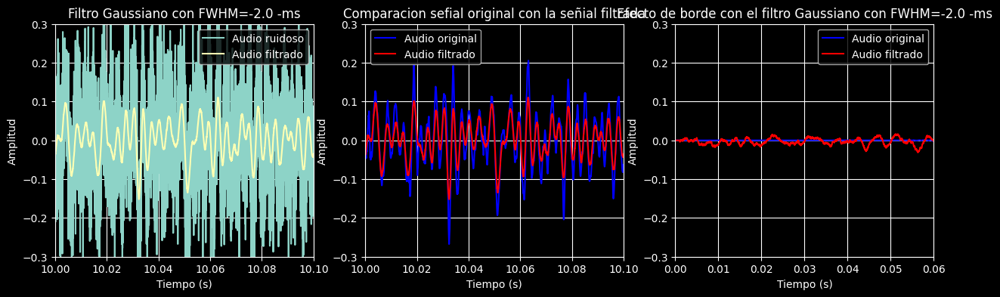

In [13]:
plt.subplots(1,3, figsize=(15, 4))

plt.subplot(131)
plt.plot(t, audio_ruidoso, label="Audio ruidoso")
plt.plot(t, audio_filtrado_gauss, label="Audio filtrado")
plt.title(f"Filtro Gaussiano con FWHM={FWHM_calculado} -ms")
plt.xlabel("Tiempo (s)")
plt.ylabel("Amplitud")
plt.axis([10,10.1, -0.3, 0.3])
plt.grid()
plt.legend()

plt.subplot(132)
plt.plot(t, audio_signal, "b", label="Audio original")
plt.plot(t, audio_filtrado_gauss, "r" ,label="Audio filtrado")
plt.title((f"Comparacion sefial original con la señial filtrada"))
plt.xlabel("Tiempo (s)")
plt.ylabel("Amplitud")
plt.axis([10,10.1, -0.3, 0.3])
plt.grid()
plt.legend()


plt.subplot(133)
plt.plot(t, audio_signal, "b", label="Audio original")
plt.plot(t, audio_filtrado_gauss, "r" ,label="Audio filtrado")
plt.title((f"Efecto de borde con el filtro Gaussiano con FWHM={FWHM_calculado} -ms"))
plt.xlabel("Tiempo (s)")
plt.ylabel("Amplitud")
plt.axis([0, 0.06, -0.3, 0.3])
plt.grid()
plt.legend()

plt.show()
# plt.plot(t, audio_signal, label="Audio original")
# plt.plot(t, audio_filtrado_gauss, label="Audio filtrado")
# plt.title(f"Filtro Gaussiano")
# plt.xlabel("Tiempo (s)")
# plt.ylabel("Amplitud")
# plt.grid()
# plt.legend()
# plt.show()

In [14]:
soundfile.write('elissir_gausiano.wav', audio_filtrado_gauss, fm)

IPython.display.Audio('elissir_gausiano.wav')

**Responda:**

**¿Que efecto sonoro identifica entre el audio original y el modificado?** (Gaussiano)

> Se aprecia que el filtro gaussiano normalizado tiene la capacidad de suavizar la señal de manera más gradual y suave que el filtro de media móvil, al tiempo que preserva detalles finos en la señal. Este filtro se utiliza en aplicaciones de procesamiento de imágenes y audio para crear efectos de "desenfoque" o suavizado estéticamente agradables, generando atmósferas suaves y difusas en el sonido.

* **Comparacion filtros**

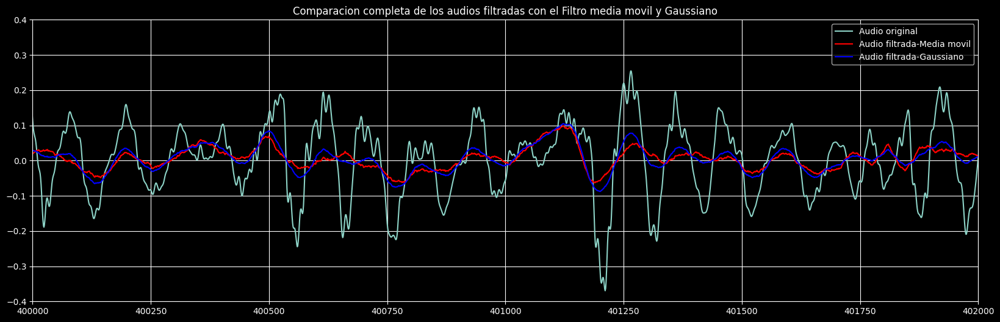

In [15]:
plt.subplots(figsize=(20, 6))

plt.plot(audio_signal, label="Audio original")
plt.plot(audio_filtrado, "r", label="Audio filtrada-Media movil")
plt.plot(audio_filtrado_gauss, "b", label="Audio filtrada-Gaussiano")
plt.title(f"Comparacion completa de los audios filtradas con el Filtro media movil y Gaussiano")
plt.grid()
plt.axis([400000,402000, -0.4, 0.4])
plt.legend()

plt.show()

###**2. Preguntas del Test de comprobación**


* **¿Cuál es la diferencia entre una señal estocástica de una señal determinística?**

Una señal determinística es aquella que sigue un patrón de comportamiento predecible y constante a lo largo del tiempo. Esto significa que, si conocemos su forma y condiciones iniciales, podemos calcular con certeza el valor de la señal en cualquier punto futuro. Estas señales están completamente descritas por ecuaciones matemáticas o fórmulas precisas, lo que permite una comprensión completa de su comportamiento. Por ejemplo, las señales determinísticas pueden ser funciones simples como senoides, lineales o cuadráticas, y su trayectoria y valores futuros son completamente conocidos.

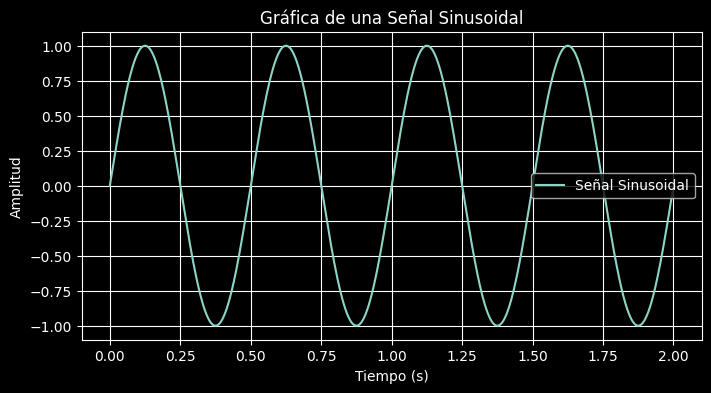

In [16]:
# Generar datos para la señal sinusoidal
frecuencia = 2  # Frecuencia de la señal en Hz
amplitud = 1.0  # Amplitud de la señal
tiempo_inicio = 0
tiempo_final = 2  # Duración de la señal en segundos
puntos = 1000  # Número de puntos en la señal

# Crear un arreglo de tiempo
t = np.linspace(tiempo_inicio, tiempo_final, puntos)

# Crear la señal sinusoidal
senal = amplitud * np.sin(2 * np.pi * frecuencia * t)

# Crear la gráfica
plt.figure(figsize=(8, 4))
plt.plot(t, senal, label='Señal Sinusoidal')
plt.xlabel('Tiempo (s)')
plt.ylabel('Amplitud')
plt.title('Gráfica de una Señal Sinusoidal')
plt.grid(True)
plt.legend()
plt.show()

Por otro lado, una señal estocástica es inherentemente impredecible y se caracteriza por un comportamiento aleatorio o probabilístico. A diferencia de las señales determinísticas, las señales estocásticas no siguen un patrón fijo y sus valores futuros no pueden ser determinados con certeza, incluso si conocemos los valores pasados y las condiciones iniciales. Esto se debe a la presencia de componentes aleatorios o ruido que influyen en la señal. Estos componentes aleatorios pueden ser el resultado de diversas fuentes, como el ruido térmico en sistemas electrónicos, eventos aleatorios en el entorno o fluctuaciones impredecibles en una señal.

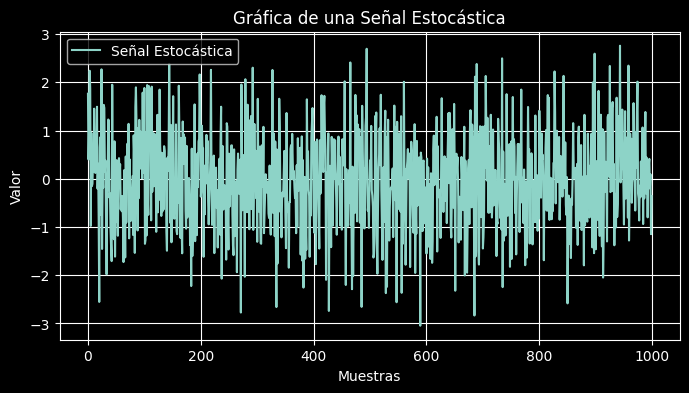

In [17]:
# Generando una señal estocástica con números aleatorios
np.random.seed(0)
muestras = 1000
senal_estocastica = np.random.normal(0, 1, muestras)  # Generar números aleatorios con distribución normal

# Crear la gráfica
plt.figure(figsize=(8, 4))
plt.plot(senal_estocastica, label='Señal Estocástica')
plt.xlabel('Muestras')
plt.ylabel('Valor')
plt.title('Gráfica de una Señal Estocástica')
plt.grid(True)
plt.legend()
plt.show()

Para analizar señales estocásticas, se utilizan herramientas estadísticas y probabilísticas. Se describen mediante funciones de densidad de probabilidad que indican la probabilidad de que la señal tome ciertos valores en un momento dado. Además, se utilizan estadísticas de segundo orden, como la media y la varianza, para caracterizar su comportamiento en términos de tendencia y dispersión.

En síntesis, las señales determinísticas se emplean en situaciones donde se requiere precisión y predictibilidad, mientras que las señales estocásticas se encuentran en contextos donde la aleatoriedad y la incertidumbre son elementos inherentes.

* **¿Qué es la tasa de muestreo de la señal?**

Las señales en la realidad, como el sonido o la luz son continuas en el tiempo, lo que significa que pueden tener un número infinito de valores en cualquier intervalo de tiempo.Para procesar y almacenar estas señales en dispositivos electrónicos, es necesario convertirlas en forma digital, es decir, en una secuencia de números discretos.

La tasa de muestreo es la velocidad a la cual se toman estas muestras. Se mide en hercios (Hz) y representa la cantidad de muestras por segundo. Por ejemplo, una tasa de muestreo de 44.1 kHz significa que se toman 44,100 muestras por segundo.

El Teorema de Muestreo de Nyquist establece que para representar adecuadamente una señal continua en forma digital, la tasa de muestreo debe ser al menos el doble de la frecuencia más alta presente en la señal. Esto se conoce como la frecuencia de Nyquist. Si no se cumple esta condición, pueden ocurrir errores de aliasing, que distorsionan la señal.

En síntesis la tasa, frecuencia de muestreo o frecuencia de muestreo Nyquist, es un parámetro esencial en el procesamiento de señales digitales que determina con qué frecuencia se toman muestras de una señal analógica continua para convertirla en una representación digital.

Se puede ver cómo la tasa de muestreo afecta la precisión de la representación discreta de la señal continua en el siguiente ejemplo.

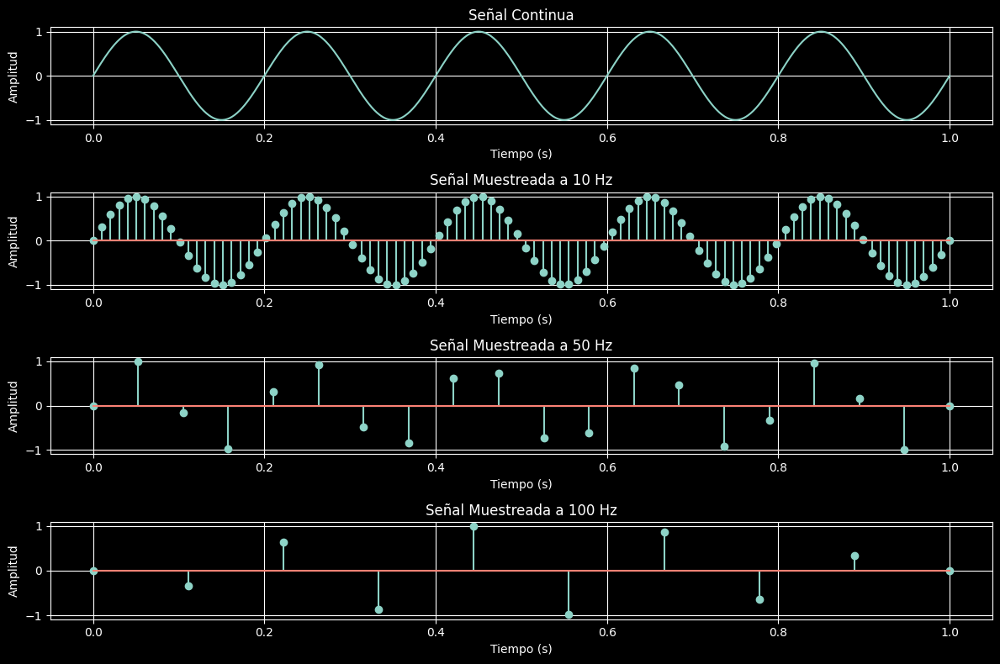

In [18]:
# Crear una señal continua (por ejemplo, una señal sinusoidal)
frecuencia = 5  # Frecuencia de la señal en Hz
amplitud = 1.0  # Amplitud de la señal
tiempo_inicio = 0
tiempo_final = 1  # Duración de la señal en segundos
muestras_continuas = 1000  # Número de puntos en la señal continua

# Crear un arreglo de tiempo para la señal continua
t_continua = np.linspace(tiempo_inicio, tiempo_final, muestras_continuas)

# Generar la señal continua (sinusoidal en este caso)
senal_continua = amplitud * np.sin(2 * np.pi * frecuencia * t_continua)

# Tasas de muestreo diferentes
tasas_muestreo = [10, 50, 100]  # Ejemplos de tasas de muestreo en Hz

# Crear subplots para las gráficas
plt.figure(figsize=(12, 8))

# Gráfica de la señal continua
plt.subplot(4, 1, 1)
plt.plot(t_continua, senal_continua, label='Señal Continua')
plt.xlabel('Tiempo (s)')
plt.ylabel('Amplitud')
plt.title('Señal Continua')
plt.grid(True)

# Gráficas de las señales muestreadas
for i, tasa_muestreo in enumerate(tasas_muestreo):
    muestras_discretas = int(muestras_continuas * tiempo_final / tasa_muestreo)
    t_discreto = np.linspace(tiempo_inicio, tiempo_final, muestras_discretas)
    senal_muestreada = amplitud * np.sin(2 * np.pi * frecuencia * t_discreto)

    plt.subplot(4, 1, i + 2)
    plt.stem(t_discreto, senal_muestreada, label=f'Señal Muestreada ({tasa_muestreo} Hz)')
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Amplitud')
    plt.title(f'Señal Muestreada a {tasa_muestreo} Hz')
    plt.grid(True)

plt.tight_layout()
plt.show()

En este código, primero creamos una señal sinusoidal continua. Luego, muestreamos esta señal a tasas de muestreo diferentes (10 Hz, 50 Hz y 100 Hz) para mostrar cómo cambia la representación discreta de la señal con diferentes tasas de muestreo.

* **¿El filtro media móvil implementado es causal?**

Un filtro se considera causal cuando el cálculo de su salida en un momento dado solo depende de las muestras pasadas de la señal de entrada y posiblemente de la muestra actual, pero no considera ninguna muestra que ocurra después de ese instante, un ejemplo es un filtro de media móvil de orden N, donde la salida en el tiempo actual se calcula promediando las últimas N muestras de la señal de entrada
Sin embargo, en nuestro caso, se ha empleado información tanto del pasado como del presente, así como del futuro, para calcular la salida en el tiempo actual. Por lo que, se ha utilizado un filtro de media móvil no causal, ya que ha promediado un conjunto específico de puntos de datos adyacentes en la señal, lo que implica la necesidad de acceder a puntos de datos futuros.








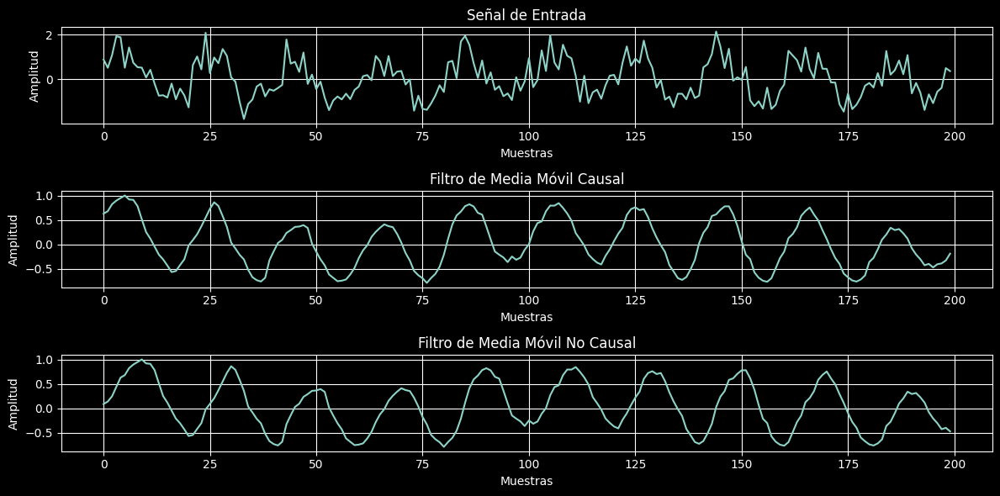

In [19]:
# Crear una señal de entrada con ruido
np.random.seed(0)
muestras = 200
ruido = np.random.normal(0, 0.5, muestras)
senal_entrada = np.sin(2 * np.pi * 0.05 * np.arange(muestras)) + ruido

# Función para calcular el filtro de media móvil causal
def filtro_media_movil_causal(senal, ventana):
    salida = np.convolve(senal, ventana, 'same') / sum(ventana)
    return salida

# Función para calcular el filtro de media móvil no causal
def filtro_media_movil_no_causal(senal, ventana):
    salida = np.convolve(senal, ventana, 'full') / sum(ventana)
    return salida[:len(senal)]

# Ventana del filtro de media móvil (por ejemplo, una ventana rectangular)
ventana = np.ones(10) / 10

# Aplicar el filtro de media móvil causal
senal_filtrada_causal = filtro_media_movil_causal(senal_entrada, ventana)

# Aplicar el filtro de media móvil no causal
senal_filtrada_no_causal = filtro_media_movil_no_causal(senal_entrada, ventana)

# Crear gráficas para comparar las señales originales y filtradas
plt.figure(figsize=(12, 6))

plt.subplot(3, 1, 1)
plt.plot(senal_entrada, label='Señal de Entrada')
plt.xlabel('Muestras')
plt.ylabel('Amplitud')
plt.title('Señal de Entrada')
plt.grid(True)

plt.subplot(3, 1, 2)
plt.plot(senal_filtrada_causal, label='Filtro Causal')
plt.xlabel('Muestras')
plt.ylabel('Amplitud')
plt.title('Filtro de Media Móvil Causal')
plt.grid(True)

plt.subplot(3, 1, 3)
plt.plot(senal_filtrada_no_causal, label='Filtro No Causal')
plt.xlabel('Muestras')
plt.ylabel('Amplitud')
plt.title('Filtro de Media Móvil No Causal')
plt.grid(True)

plt.tight_layout()
plt.show()

Se puede observar cómo el filtro causal tiene un retraso en la señal filtrada, ya que depende de las muestras pasadas, mientras que el filtro no causal no tiene ese retraso pero puede requerir información del futuro, lo que puede no ser práctico en algunas aplicaciones. Esto ilustra la diferencia fundamental entre los dos tipos de filtros